### Credit Card Lead Prediction
Happy Customer Bank is a mid-sized private bank that deals in all kinds of banking products, like Savings accounts, Current accounts, investment products, credit products, among other offerings.



The bank also cross-sells products to its existing customers and to do so they use different kinds of communication like tele-calling, e-mails, recommendations on net banking, mobile banking, etc. 



In this case, the Happy Customer Bank wants to cross sell its credit cards to its existing customers. The bank has identified a set of customers that are eligible for taking these credit cards.



Now, the bank is looking for your help in identifying customers that could show higher intent towards a recommended credit card, given:

*  Customer details (gender, age, region etc.)
* Details of his/her relationship with the bank (Channel_Code,Vintage, 'Avg_Asset_Value etc.)

Data Dictionary



| Variable   | Definition | 
| ---        | ---        |
| ID  | Unique Identifier for a row   |
| Gender  | Gender of the Customer   |
| Age  | Age of the Customer (in Years)   |
| Region_Code  | Code of the Region for the customers   |
| Occupation  | Occupation Type for the customer   |
| Channel_Code  | Acquisition Channel Code for the Customer  (Encoded)   |
| Vintage  | Vintage for the Customer (In Months)   |
| Credit_Product  | If the Customer has any active credit product (Home loan,Personal loan, Credit Card etc.)   |
| Avg_Account_Balance  | Average Account Balance for the Customer in last 12 Months   |
| Is_Active  | If the Customer is Active in last 3 Months   |
| Is_Lead(Target)  | If the Customer is interested for the Credit Card 0 : Customer is not interested 1 : Customer is interested   |

In [1]:
#basic
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import scipy.stats as stats
import plotly.express as px
%matplotlib inline
import warnings
warnings.filterwarnings("ignore")

In [2]:
import logging
logging.basicConfig(filename='Log.log',  format='[%(asctime)s] (%(levelname)s): %(message)s', level=logging.INFO)
pd.set_option('display.float_format', lambda x: '%.6f' % x)

In [3]:
def Log_model():
    model=input("Model: ")
    model_parameters=input("Model parameters: ")
    eval_metrics=input("evaluation metrics: ")
    model_eval_score=input("evaluation Score: ")
    Add_cmnt=input("Additional comment: ")
    logging.info('Model used: {}, Model Parameters: {}, Evaluation Metrics: {}, Evaluation Score: {}, Additional Info: {}'.format(model,model_parameters,eval_metrics,model_eval_score,Add_cmnt))
    print("Logged Successfully")
def Log_Message():
    Message=input("Enter Message: ")
    logging.info('Message: {} '.format(Message))
    print("Logged Successfully")

In [5]:
Log_Message()

Enter Message:  @utor: Vishal @email: vishalsjadhav53@gmail.com
Logged Successfully


In [102]:
#classification
from sklearn.metrics import accuracy_score, f1_score, roc_auc_score,roc_curve,confusion_matrix,classification_report
from category_encoders import CountEncoder
from sklearn.preprocessing import StandardScaler
from sklearn.linear_model import LogisticRegression
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import train_test_split, StratifiedKFold,KFold, GridSearchCV, cross_val_score ,RandomizedSearchCV
from lightgbm import LGBMClassifier
from catboost import CatBoostClassifier
from xgboost import XGBClassifier 
from imblearn.over_sampling import SMOTE
from sklearn.experimental import enable_iterative_imputer
from sklearn.impute import IterativeImputer
from sklearn.model_selection import StratifiedKFold, KFold

In [5]:
train=pd.read_csv('train.csv')
test=pd.read_csv('test.csv')
train['train_or_test']='train'
test['train_or_test']='test'
data=pd.concat([train,test]).reset_index(drop=True)

In [6]:
data.head()

,ID,Gender,Age,Region_Code,Occupation,Channel_Code,Vintage,Credit_Product,Avg_Account_Balance,Is_Active,Is_Lead,train_or_test
0,NNVBBKZB,Female,73,RG268,Other,X3,43,No,1045696,No,0.000000,train
1,IDD62UNG,Female,30,RG277,Salaried,X1,32,No,581988,No,0.000000,train
2,HD3DSEMC,Female,56,RG268,Self_Employed,X3,26,No,1484315,Yes,0.000000,train
3,BF3NC7KV,Male,34,RG270,Salaried,X1,19,No,470454,No,0.000000,train
4,TEASRWXV,Female,30,RG282,Salaried,X1,33,No,886787,No,0.000000,train


In [7]:
data.columns=[i.lower() for i in data.columns]

In [8]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 351037 entries, 0 to 351036
Data columns (total 12 columns):
 #   Column               Non-Null Count   Dtype  
---  ------               --------------   -----  
 0   id                   351037 non-null  object 
 1   gender               351037 non-null  object 
 2   age                  351037 non-null  int64  
 3   region_code          351037 non-null  object 
 4   occupation           351037 non-null  object 
 5   channel_code         351037 non-null  object 
 6   vintage              351037 non-null  int64  
 7   credit_product       309190 non-null  object 
 8   avg_account_balance  351037 non-null  int64  
 9   is_active            351037 non-null  object 
 10  is_lead              245725 non-null  float64
 11  train_or_test        351037 non-null  object 
dtypes: float64(1), int64(3), object(8)
memory usage: 32.1+ MB


* Observed missing values in credit_product

In [441]:
Log_Message()

Enter Message: 
Logged Successfully


In [9]:
data.shape

(351037, 12)

In [10]:
data.columns

Index(['id', 'gender', 'age', 'region_code', 'occupation', 'channel_code',
       'vintage', 'credit_product', 'avg_account_balance', 'is_active',
       'is_lead', 'train_or_test'],
      dtype='object')

Introducing new KPIs based on current data

In [11]:
#Avg balance for each occupation
data['occupation_avg_balance'] =data.groupby('occupation')['avg_account_balance'].transform('mean')
#Avg balance for active vs non active
data['is_active_avg_balance']=data.groupby('is_active')['avg_account_balance'].transform('mean')
#Avg balance for male vs females
data['gender_avg_balance'] = data.groupby('gender')['avg_account_balance'].transform('mean')
#Gender gender channelcode
data['gender_and_channelcode'] =data['gender'].astype('str') + data['channel_code'].astype('str')
#Gendar occupation
data['gender_and_occupation'] = data['gender'].astype('str') + data['occupation'].astype('str')
#Gendar Active
data['gender_and_active'] = data['gender'].astype('str') + data['is_active'].astype('str')

In [12]:
#final data
data.head(2)

,id,gender,age,region_code,occupation,channel_code,vintage,credit_product,avg_account_balance,is_active,is_lead,train_or_test,occupation_avg_balance,is_active_avg_balance,gender_avg_balance,gender_and_channelcode,gender_and_occupation,gender_and_active
0,NNVBBKZB,Female,73,RG268,Other,X3,43,No,1045696,No,0.000000,train,1211035.403075,1078115.795915,1108036.760775,FemaleX3,FemaleOther,FemaleNo
1,IDD62UNG,Female,30,RG277,Salaried,X1,32,No,581988,No,0.000000,train,1036457.106868,1078115.795915,1108036.760775,FemaleX1,FemaleSalaried,FemaleNo


#### Data Visualization

In [199]:
px.histogram(data,'avg_account_balance',marginal='box',color='gender')

In [200]:
px.histogram(data,'age',marginal='box',color='gender')

Text(0.5, 1.0, 'channel_code')

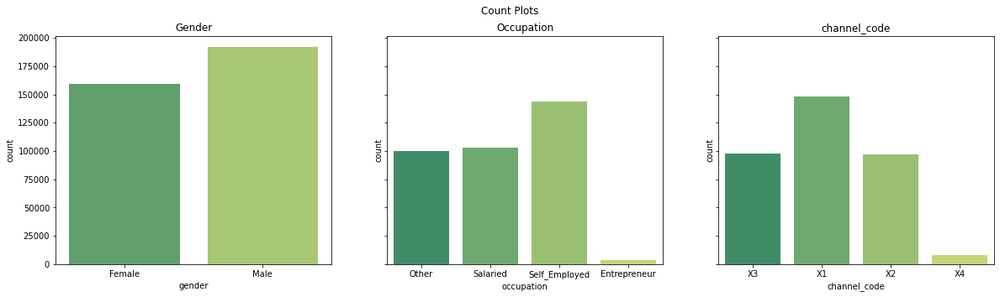

In [201]:
fig, axes = plt.subplots(1, 3, figsize=(20, 5), sharey=True)
fig.suptitle('Count Plots')

# Gender
sns.countplot('gender',data=data,palette='summer',ax=axes[0])
axes[0].set_title('Gender')

# occupation
sns.countplot('occupation',data=data,palette='summer',ax=axes[1])
axes[1].set_title('Occupation')

# occupation
sns.countplot('channel_code',data=data,palette='summer',ax=axes[2])
axes[2].set_title('channel_code')

*  Most of customers are self employed customers followd by salared and other
*  We have very less enterpreneurs
*  Channel X1 is more effective in accquring cutomers followed by X3 and X2
*  Channel x4 is not that effective compaire to others
*  We have more Men Customers 

Text(0.5, 1.0, 'Gender Active')

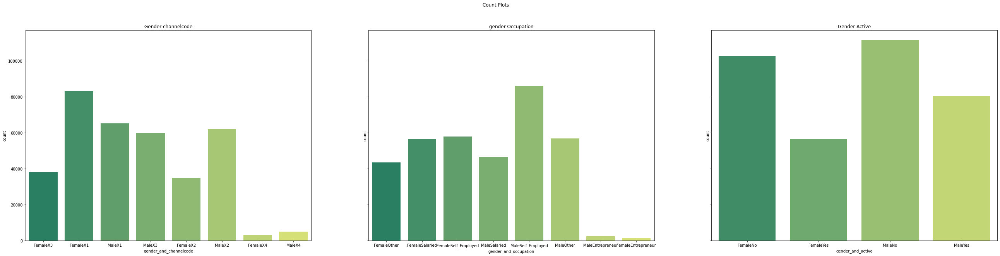

In [211]:
fig, axes = plt.subplots(1, 3, figsize=(45, 10), sharey=True)
fig.suptitle('Count Plots')

# Gender
sns.countplot('gender_and_channelcode',data=data,palette='summer',ax=axes[0])
axes[0].set_title('Gender channelcode')

# occupation
sns.countplot('gender_and_occupation',data=data,palette='summer',ax=axes[1])
axes[1].set_title('gender Occupation')

# occupation
sns.countplot('gender_and_active',data=data,palette='summer',ax=axes[2])
axes[2].set_title('Gender Active')

* Huge female customers acquired by X1
* Huge male customers acquired by X1, X3,X2
* We have huge number of selfemployed males
* We have comparatively high active males

<AxesSubplot:xlabel='region_code', ylabel='count'>

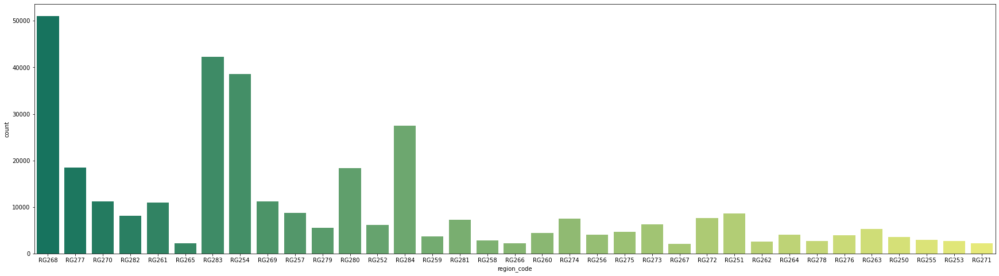

In [212]:
plt.figure(figsize=(30,8))
sns.countplot('region_code',data=data,palette='summer')

*  Region RG268 have high number of customers comapir to others
*  We have huge number of customers in Region RG268,RG283,RG254 and RG284 

#### Numeric vs Categorical

* Seperating Out the num and cat data for furthr EDA

In [13]:
id_col,target=  'id','is_lead'

In [14]:
print(data.dtypes)

id                         object
gender                     object
age                         int64
region_code                object
occupation                 object
channel_code               object
vintage                     int64
credit_product             object
avg_account_balance         int64
is_active                  object
is_lead                   float64
train_or_test              object
occupation_avg_balance    float64
is_active_avg_balance     float64
gender_avg_balance        float64
gender_and_channelcode     object
gender_and_occupation      object
gender_and_active          object
dtype: object


In [235]:
numeric_cols=[key for key in dict(data.dtypes) if dict(data.dtypes)[key] in ['int64','float64','int32','float32']]
categorical_cols=[key for key in dict(data.dtypes) if dict(data.dtypes)[key] in ['object']]

In [236]:
print(numeric_cols)
print(categorical_cols)

['age', 'vintage', 'avg_account_balance', 'is_lead', 'occupation_avg_balance', 'is_active_avg_balance', 'gender_avg_balance', 'log_avg_account_balance']
['id', 'gender', 'region_code', 'occupation', 'channel_code', 'credit_product', 'is_active', 'train_or_test', 'gender_and_channelcode', 'gender_and_occupation', 'gender_and_active']


In [237]:
id_col,target_col="id","is_lead"

In [238]:
cat_data=data[categorical_cols]
num_data=data[numeric_cols]
del cat_data['train_or_test']
del cat_data[id_col]
del num_data[target_col]

*  num_data Num data

In [239]:
num_data.head()

,age,vintage,avg_account_balance,occupation_avg_balance,is_active_avg_balance,gender_avg_balance,log_avg_account_balance
0,73,43,1045696,1211035.403075,1078115.795915,1108036.760775,13.860193
1,30,32,581988,1036457.106868,1078115.795915,1108036.760775,13.274205
2,56,26,1484315,1133054.659983,1211468.277641,1108036.760775,14.210464
3,34,19,470454,1036457.106868,1078115.795915,1148470.193625,13.061453
4,30,33,886787,1036457.106868,1078115.795915,1108036.760775,13.695360


In [240]:
# Creating Data audit for numeric data
def var_summary(x):
    return pd.Series([x.count(), x.isnull().sum(), x.sum(), x.mean(), x.median(),  x.std(), x.var(), x.min(), x.dropna().quantile(0.01), x.dropna().quantile(0.05),x.dropna().quantile(0.10),x.dropna().quantile(0.25),x.dropna().quantile(0.50),x.dropna().quantile(0.75), x.dropna().quantile(0.90),x.dropna().quantile(0.95), x.dropna().quantile(0.99),x.max()], 
                  index=['N', 'NMISS', 'SUM', 'MEAN','MEDIAN', 'STD', 'VAR', 'MIN', 'P1' , 'P5' ,'P10' ,'P25' ,'P50' ,'P75' ,'P90' ,'P95' ,'P99' ,'MAX'])

num_summary=num_data.apply(var_summary).T
num_summary.to_excel("num_summary.xlsx")

In [241]:
num_summary

,N,NMISS,SUM,MEAN,MEDIAN,STD,VAR,MIN,P1,P5,P10,P25,P50,P75,P90,P95,P99,MAX
age,351037.000000,0.000000,15396734.000000,43.860716,43.000000,14.841932,220.282933,23.000000,25.000000,26.000000,27.000000,30.000000,43.000000,54.000000,64.000000,73.000000,82.000000,85.000000
vintage,351037.000000,0.000000,16472146.000000,46.924244,32.000000,32.329303,1045.183857,7.000000,13.000000,13.000000,14.000000,20.000000,32.000000,73.000000,98.000000,110.000000,123.000000,135.000000
avg_account_balance,351037.000000,0.000000,396721157023.000000,1130140.574991,895162.000000,856952.950112,734368358705.359619,20790.000000,233672.240000,353922.400000,432041.000000,604185.000000,895162.000000,1368152.000000,2048119.200000,2680544.000000,4518456.000000,10352009.000000
occupation_avg_balance,351037.000000,0.000000,396721157023.000122,1130140.574990,1133054.659983,73344.258401,5379380240.427030,1036457.106868,1036457.106868,1036457.106868,1036457.106868,1036457.106868,1133054.659983,1211035.403075,1211035.403075,1211035.403075,1425952.142666,1425952.142666
is_active_avg_balance,351037.000000,0.000000,396721157023.000061,1130140.574993,1078115.795915,65046.658763,4231067816.227005,1078115.795915,1078115.795915,1078115.795915,1078115.795915,1078115.795915,1078115.795915,1211468.277641,1211468.277641,1211468.277641,1211468.277641,1211468.277641
gender_avg_balance,351037.000000,0.000000,396721157023.000000,1130140.574991,1148470.193625,20128.478310,405155639.094725,1108036.760775,1108036.760775,1108036.760775,1108036.760775,1108036.760775,1148470.193625,1148470.193625,1148470.193625,1148470.193625,1148470.193625,1148470.193625
log_avg_account_balance,351037.000000,0.000000,4821233.184240,13.734259,13.704760,0.620477,0.384992,9.942227,12.361675,12.776833,12.976276,13.311636,13.704760,14.128971,14.532432,14.801530,15.323681,16.152691


In [242]:
#Handling Outliers
def outlier_capping(x):
    x=x.clip(upper=x.quantile(0.99),lower=x.quantile(0.01))
    #x = x.clip(lower=x.quantile(0.01))
    return x
num_data=num_data.apply(outlier_capping)

In [243]:
tstats_df = pd.DataFrame()
for num_variable in num_data.columns:
    tstats = stats.ttest_ind(data[data['is_lead']==1][num_variable],data[data['is_lead']==0][num_variable])
    temp = pd.DataFrame([num_variable, tstats[0], tstats[1]]).T
    temp.columns = ['Variable Name', 'T-Statistic', 'P-Value']
    tstats_df = pd.concat([tstats_df, temp], axis=0, ignore_index=True)

print(tstats_df)

             Variable Name T-Statistic P-Value
0                      age  117.590633     0.0
1                  vintage  144.379997     0.0
2      avg_account_balance   26.493741     0.0
3   occupation_avg_balance   59.341843     0.0
4    is_active_avg_balance   42.650474     0.0
5       gender_avg_balance   35.817536     0.0
6  log_avg_account_balance   36.428648     0.0


As shows in above we get max out log_avg_account_balance than avg_account_balance

In [244]:
data['log_avg_account_balance']=np.log(data['avg_account_balance'])
num_data['log_avg_account_balance']=np.log(num_data['avg_account_balance'])

In [245]:
del num_data['avg_account_balance']

In [246]:
num_data.head(2)

,age,vintage,occupation_avg_balance,is_active_avg_balance,gender_avg_balance,log_avg_account_balance
0,73,43,1211035.403075,1078115.795915,1108036.760775,13.860193
1,30,32,1036457.106868,1078115.795915,1108036.760775,13.274205


####  Categorical data EDA

In [247]:
def cat_var_summary(x):
    return pd.Series(data=[x.count(),x.isnull().sum(),x.isnull().sum()/x.shape[0],len(x.unique()),x.mode()[0]],
                     index=['N','NMiss','Missing %','Distinct Category','Mode'])

In [249]:
cat_summary=cat_data.apply(cat_var_summary)

In [250]:
cat_summary

,gender,region_code,occupation,channel_code,credit_product,is_active,gender_and_channelcode,gender_and_occupation,gender_and_active
N,351037,351037,351037,351037,309190,351037,351037,351037,351037
NMiss,0,0,0,0,41847,0,0,0,0
Missing %,0.0,0.0,0.0,0.0,0.11921,0.0,0.0,0.0,0.0
Distinct Category,2,35,4,4,3,2,8,8,4
Mode,Male,RG268,Self_Employed,X1,No,No,FemaleX1,MaleSelf_Employed,MaleNo


In [251]:
cat_summary.to_excel("Cat data summry.xlsx")

In [252]:
cat_data.head(2)

,gender,region_code,occupation,channel_code,credit_product,is_active,gender_and_channelcode,gender_and_occupation,gender_and_active
0,Female,RG268,Other,X3,No,No,FemaleX3,FemaleOther,FemaleNo
1,Female,RG277,Salaried,X1,No,No,FemaleX1,FemaleSalaried,FemaleNo


* Missing value imputation

In [60]:
#% of missing values
cat_data.isnull().sum()/cat_data.shape[0] *100

gender                    0.000000
region_code               0.000000
occupation                0.000000
channel_code              0.000000
credit_product           11.920966
is_active                 0.000000
gender_and_channelcode    0.000000
gender_and_occupation     0.000000
gender_and_active         0.000000
dtype: float64

In [61]:
Log_Message()

Enter Message: 
Logged Successfully


In [63]:
num_data['credit_product']=cat_data['credit_product']

In [64]:
num_data.credit_product=np.where(num_data.credit_product=='Yes',1,
                                    np.where(num_data.credit_product=='No',0,num_data.credit_product))

In [65]:
num_data.credit_product.unique()

array([0, nan, 1], dtype=object)

In [66]:
impute_it=IterativeImputer()
num_data_filled=pd.DataFrame(np.round(impute_it.fit_transform(num_data)),columns=num_data.columns)

In [67]:
num_data_filled.credit_product=num_data_filled.credit_product.astype(int)

In [68]:
num_data_filled.credit_product.unique()

array([0, 1])

In [69]:
num_data_filled.credit_product=np.where(num_data_filled.credit_product==1,'Yes','No')

In [70]:
del cat_data['credit_product']
del num_data['credit_product']

In [71]:
cat_data['credit_product']=num_data_filled['credit_product']

In [72]:
cat_data.credit_product.unique()

array(['No', 'Yes'], dtype=object)

##### Applying feature encoding

In [73]:
cat_col=[i for i in cat_data.columns]
ce = CountEncoder()
count_encoded = ce.fit_transform(cat_data[cat_col])
cat_data = cat_data.join(count_encoded.add_suffix("_count"))
cat_data.drop(cat_col,axis=1,inplace=True)

In [74]:
cat_data.head(2)

,gender_count,region_code_count,occupation_count,channel_code_count,is_active_count,gender_and_channelcode_count,gender_and_occupation_count,gender_and_active_count,credit_product_count
0,159135,51059,100304,97981,214087,38093,43406,102649,237925
1,159135,18422,102912,148202,214087,83061,56378,102649,237925


In [75]:
final_data=pd.concat([num_data,cat_data],axis=1)
final_data['id']=data[['id']]
final_data['train_or_test']=data['train_or_test']
final_data['is_lead']=data['is_lead']

In [76]:
final_data.head(2)

,age,vintage,occupation_avg_balance,is_active_avg_balance,gender_avg_balance,log_avg_account_balance,gender_count,region_code_count,occupation_count,channel_code_count,is_active_count,gender_and_channelcode_count,gender_and_occupation_count,gender_and_active_count,credit_product_count,id,train_or_test,is_lead
0,73,43,1211035.403075,1078115.795915,1108036.760775,13.860193,159135,51059,100304,97981,214087,38093,43406,102649,237925,NNVBBKZB,train,0.000000
1,30,32,1036457.106868,1078115.795915,1108036.760775,13.274205,159135,18422,102912,148202,214087,83061,56378,102649,237925,IDD62UNG,train,0.000000


In [77]:
final_data.columns

Index(['age', 'vintage', 'occupation_avg_balance', 'is_active_avg_balance',
       'gender_avg_balance', 'log_avg_account_balance', 'gender_count',
       'region_code_count', 'occupation_count', 'channel_code_count',
       'is_active_count', 'gender_and_channelcode_count',
       'gender_and_occupation_count', 'gender_and_active_count',
       'credit_product_count', 'id', 'train_or_test', 'is_lead'],
      dtype='object')

In [78]:
train_final=final_data.loc[final_data.train_or_test=='train',:]
test_final=final_data.loc[final_data.train_or_test=='test',:]
del train_final['train_or_test']
del test_final['is_lead']
del test_final['train_or_test']
del test_final['id']
del train_final['id']

In [79]:
train_final['is_lead']=train_final.is_lead.astype(int)

In [80]:
train_final.head()

,age,vintage,occupation_avg_balance,is_active_avg_balance,gender_avg_balance,log_avg_account_balance,gender_count,region_code_count,occupation_count,channel_code_count,is_active_count,gender_and_channelcode_count,gender_and_occupation_count,gender_and_active_count,credit_product_count,is_lead
0,73,43,1211035.403075,1078115.795915,1108036.760775,13.860193,159135,51059,100304,97981,214087,38093,43406,102649,237925,0
1,30,32,1036457.106868,1078115.795915,1108036.760775,13.274205,159135,18422,102912,148202,214087,83061,56378,102649,237925,0
2,56,26,1133054.659983,1211468.277641,1108036.760775,14.210464,159135,51059,144078,97981,136950,38093,58002,56486,237925,0
3,34,19,1036457.106868,1078115.795915,1148470.193625,13.061453,191902,11160,102912,148202,214087,65141,46534,111438,237925,0
4,30,33,1036457.106868,1078115.795915,1108036.760775,13.695360,159135,8166,102912,148202,214087,83061,56378,102649,237925,0


<AxesSubplot:xlabel='is_lead', ylabel='count'>

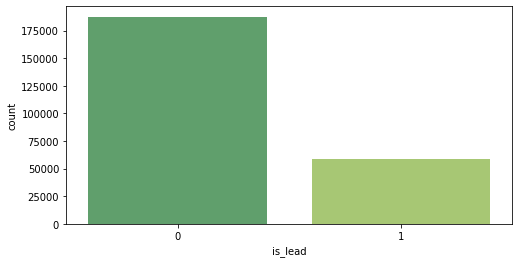

In [81]:
plt.figure(figsize=(8,4))
sns.countplot('is_lead',data=train_final,palette='summer')

In [82]:
train_final.is_lead.value_counts()/len(train_final)*100

0   76.279174
1   23.720826
Name: is_lead, dtype: float64

#### Train and Validation set

In [83]:
X=train_final[[i for i in train_final.columns.drop('is_lead')]]
y=train_final[['is_lead']]

In [84]:
X_train, X_val, y_train, y_val=train_test_split(X, y, test_size=0.20, random_state=42,stratify=y)

In [85]:
print(X_train.shape)
print(X_val.shape)

(196580, 15)
(49145, 15)


Validation data distribution: 
0   76.278360
1   23.721640
Name: is_lead, dtype: float64
************
Train data distribution: 
0   76.279377
1   23.720623
Name: is_lead, dtype: float64


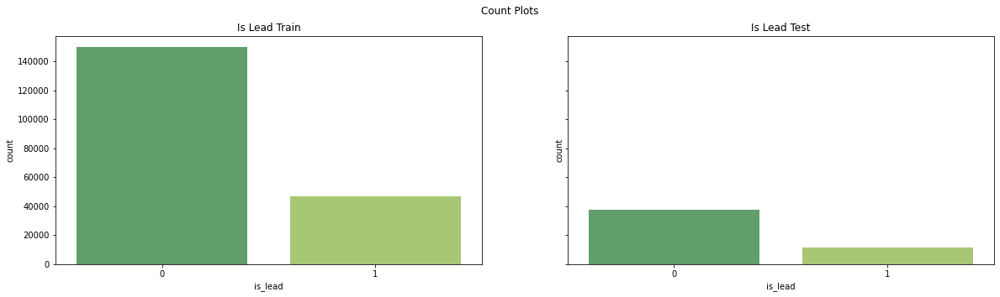

In [86]:
fig, axes = plt.subplots(1, 2, figsize=(20, 5), sharey=True)
fig.suptitle('Count Plots')
#train
sns.countplot('is_lead',data=y_train,palette='summer',ax=axes[0])
axes[0].set_title('Is Lead Train')
#test
sns.countplot('is_lead',data=y_val,palette='summer',ax=axes[1])
axes[1].set_title('Is Lead Test')
#distribution
print("Validation data distribution: ")
print(y_val.is_lead.value_counts()/len(y_val)*100)
print("************")
print("Train data distribution: ")
print(y_train.is_lead.value_counts()/len(y_train)*100)

#### Performing Oversampling

In [87]:
%%time
smote = SMOTE(random_state = 2)
X_sm, y_sm = smote.fit_resample(X_train, y_train)

Wall time: 4.74 s


### Model Building

In [122]:
def feature_importances(fited_model,X_train,Model_desc):
    importance=fited_model.feature_importances_
    df=pd.DataFrame([i for i in X_train.columns],columns=["Var"])
    df["Importance"]=importance
    #df.sort_values(by='Importance')
    print("@@@@@@@@@@@@@@Importance@@@@@@@@@")
    print(df.sort_values(by='Importance').reset_index(drop=True))
    df=df.sort_values(by='Importance')
    df.to_csv(Model_desc+"Importance.csv",index=False)
    print("@@@@@@@@@@@graph@@@@@@@@")
    plt.figure(figsize=(20,7))
    sns.barplot(y="Var",x="Importance",data=df,orient='h')
    plt.show()

In [169]:
def model_eval(model,X_train,y_train):
    pred=model.predict(X_val)
    print("@@@@@@@@@@@@@@@cross_val_score@@@@@@@@@@@@@@@@@@@@@@")
    scores=cross_val_score(model,X_train,y_train,cv=10,scoring='roc_auc')
    print(scores,"Avg Score: ",scores.mean())
    print("@@@@@@@@@@@@@@@@@@@@roc_auc_score@@@@@@@@@@@@@@@@@@")
    print(roc_auc_score(y_val,model.predict_proba(X_val)[:, 1]))
    print("@@@@@@@@@@@@@@classification_report@@@@@@@@@@@@@@@@")
    print(classification_report(y_val,pred))
    print("@@@@@@@@@@@@@@@@@@@confusion_matrix@@@@@@@@@@@@@@@")
    print(confusion_matrix(y_val,pred))
def model_eval2(model,X_train,y_train,X_val):
    pred=model.predict(X_val)
    print("@@@@@@@@@@@@@@@cross_val_score@@@@@@@@@@@@@@@@@@@@@@")
    scores=cross_val_score(model,X_train,y_train,cv=10,scoring='roc_auc')
    print(scores,"Avg Score: ",scores.mean())
    print("@@@@@@@@@@@@@@@@@@@@roc_auc_score@@@@@@@@@@@@@@@@@@")
    print(roc_auc_score(y_val,model.predict_proba(X_val)[:, 1]))
    print("@@@@@@@@@@@@@@classification_report@@@@@@@@@@@@@@@@")
    print(classification_report(y_val,pred))
    print("@@@@@@@@@@@@@@@@@@@confusion_matrix@@@@@@@@@@@@@@@")
    print(confusion_matrix(y_val,pred))

*  Logistic
 * Without oversampling

In [103]:
lr_clf=LogisticRegression()
lr_clf.fit(X_train,y_train)
lr_pred=lr_clf.predict(X_val)

In [109]:
model_eval(lr_clf,X_train,y_train)

@@@@@@@@@@@@@@@cross_val_score@@@@@@@@@@@@@@@@@@@@@@
[0.71240245 0.71193446 0.7122234  0.71521709 0.71379044 0.71296629
 0.71358489 0.70504188 0.71478073 0.71633726] Avg Score:  0.7128278880865071
@@@@@@@@@@@@@@@@@@@@roc_auc_score@@@@@@@@@@@@@@@@@@
0.7125695002185306
@@@@@@@@@@@@@@classification_report@@@@@@@@@@@@@@@@
              precision    recall  f1-score   support

           0       0.77      0.97      0.86     37487
           1       0.41      0.07      0.12     11658

    accuracy                           0.76     49145
   macro avg       0.59      0.52      0.49     49145
weighted avg       0.69      0.76      0.68     49145

@@@@@@@@@@@@@@@@@@@confusion_matrix@@@@@@@@@@@@@@@
[[36386  1101]
 [10877   781]]


In [224]:
Log_model()

Model: Logistic without oversampling 
Model parameters: 
evaluation metrics: roc_auc_score
evaluation Score: 0.7125695002185306
Additional comment: cross_val_score is 0.7128278880865071
Logged Successfully


   *  With oversampling

In [112]:
lr_clf2=LogisticRegression()
lr_clf2.fit(X_sm,y_sm)
lr_pred2=lr_clf2.predict(X_val)

In [113]:
model_eval(lr_clf2,X_sm,y_sm)

@@@@@@@@@@@@@@@cross_val_score@@@@@@@@@@@@@@@@@@@@@@
[0.71780113 0.71947115 0.71897263 0.71982406 0.71552202 0.7118797
 0.71099514 0.71238715 0.71675797 0.71870527] Avg Score:  0.7162316221668198
@@@@@@@@@@@@@@@@@@@@roc_auc_score@@@@@@@@@@@@@@@@@@
0.7165180595367873
@@@@@@@@@@@@@@classification_report@@@@@@@@@@@@@@@@
              precision    recall  f1-score   support

           0       0.86      0.63      0.73     37487
           1       0.36      0.68      0.47     11658

    accuracy                           0.64     49145
   macro avg       0.61      0.65      0.60     49145
weighted avg       0.74      0.64      0.67     49145

@@@@@@@@@@@@@@@@@@@confusion_matrix@@@@@@@@@@@@@@@
[[23729 13758]
 [ 3769  7889]]


In [225]:
Log_model()

Model: Logistic with oversampling 
Model parameters: default
evaluation metrics: roc_auc_score
evaluation Score: 0.7165180595367873
Additional comment: cross_val_score  0.7162316221668198, Recall for 1's 0.68 
Logged Successfully


* Random Forest
  * Without oversampling

In [117]:
RF_clf=RandomForestClassifier(n_estimators=100)
RF_clf.fit(X_train,y_train)
RF_clf_pred=RF_clf.predict(X_val)

In [118]:
model_eval(RF_clf,X_train,y_train)

@@@@@@@@@@@@@@@cross_val_score@@@@@@@@@@@@@@@@@@@@@@
[0.75866721 0.76591618 0.75701779 0.76260359 0.76595928 0.75600345
 0.7708188  0.75146267 0.76413834 0.7689585 ] Avg Score:  0.7621545805138992
@@@@@@@@@@@@@@@@@@@@roc_auc_score@@@@@@@@@@@@@@@@@@
0.7607053489757161
@@@@@@@@@@@@@@classification_report@@@@@@@@@@@@@@@@
              precision    recall  f1-score   support

           0       0.82      0.92      0.86     37487
           1       0.56      0.34      0.43     11658

    accuracy                           0.78     49145
   macro avg       0.69      0.63      0.65     49145
weighted avg       0.76      0.78      0.76     49145

@@@@@@@@@@@@@@@@@@@confusion_matrix@@@@@@@@@@@@@@@
[[34384  3103]
 [ 7667  3991]]


@@@@@@@@@@@@@@Importance@@@@@@@@@
                             Var  Importance
0             gender_avg_balance    0.001682
1                   gender_count    0.001840
2          is_active_avg_balance    0.003247
3                is_active_count    0.003338
4        gender_and_active_count    0.003988
5               occupation_count    0.009300
6    gender_and_occupation_count    0.012544
7         occupation_avg_balance    0.020428
8           credit_product_count    0.028256
9             channel_code_count    0.032419
10  gender_and_channelcode_count    0.032622
11             region_code_count    0.138617
12                           age    0.195206
13                       vintage    0.208277
14       log_avg_account_balance    0.308237
@@@@@@@@@@@graph@@@@@@@@


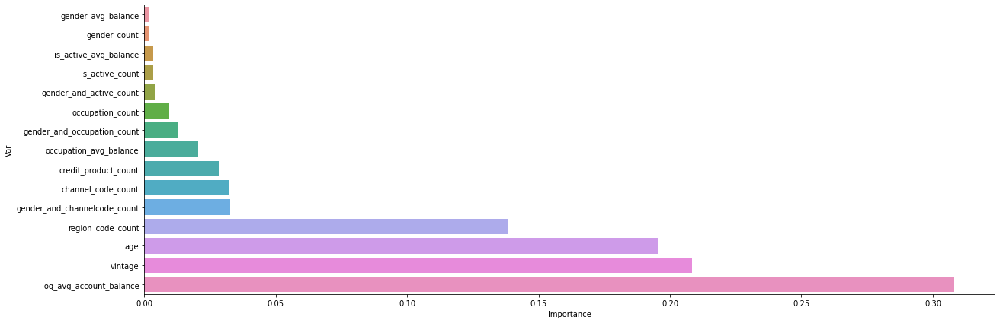

In [157]:
feature_importances(RF_clf,X_train,"RF_without_oversampling")

In [226]:
Log_model()

Model: Random Forest without oversampling
Model parameters: n_estimators=100 and default
evaluation metrics: roc_auc_score
evaluation Score: 0.7607053489757161
Additional comment: cross_val_score 0.7621545805138992, Recall for 1's 0.43 is 
Logged Successfully


* With oversampling

In [119]:
RF_clf2=RandomForestClassifier(n_estimators=100)
RF_clf2.fit(X_sm,y_sm)
RF_clf2_pred=RF_clf2.predict(X_val)

In [120]:
model_eval(RF_clf2,X_sm,y_sm)

@@@@@@@@@@@@@@@cross_val_score@@@@@@@@@@@@@@@@@@@@@@
[0.84701474 0.85229069 0.84680018 0.89511314 0.90587222 0.9033075
 0.90316872 0.90246432 0.90628018 0.90636446] Avg Score:  0.8868676149802518
@@@@@@@@@@@@@@@@@@@@roc_auc_score@@@@@@@@@@@@@@@@@@
0.7546323647358728
@@@@@@@@@@@@@@classification_report@@@@@@@@@@@@@@@@
              precision    recall  f1-score   support

           0       0.85      0.78      0.82     37487
           1       0.45      0.57      0.50     11658

    accuracy                           0.73     49145
   macro avg       0.65      0.68      0.66     49145
weighted avg       0.76      0.73      0.74     49145

@@@@@@@@@@@@@@@@@@@confusion_matrix@@@@@@@@@@@@@@@
[[29378  8109]
 [ 4997  6661]]


@@@@@@@@@@@@@@Importance@@@@@@@@@
                             Var  Importance
0             gender_avg_balance    0.001269
1                   gender_count    0.001324
2          is_active_avg_balance    0.003713
3                is_active_count    0.003877
4        gender_and_active_count    0.004828
5               occupation_count    0.007780
6    gender_and_occupation_count    0.009844
7         occupation_avg_balance    0.013620
8           credit_product_count    0.028699
9             channel_code_count    0.033991
10  gender_and_channelcode_count    0.042798
11             region_code_count    0.139170
12                           age    0.206335
13                       vintage    0.223100
14       log_avg_account_balance    0.279654
@@@@@@@@@@@graph@@@@@@@@


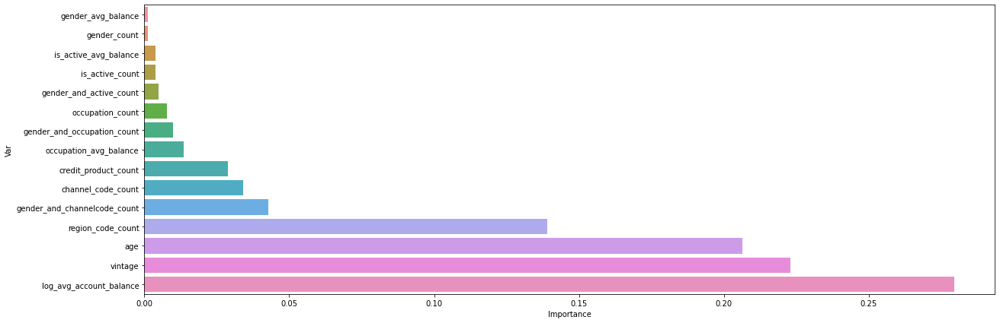

In [156]:
feature_importances(RF_clf2,X_sm,"RF_with_oversampling")

In [227]:
Log_model()

Model: Random Forest with oversampling
Model parameters: n_estimators=100
evaluation metrics: roc_auc_score
evaluation Score: 0.7546323647358728
Additional comment: cross_val_score 0.8868676149802518, Recall for 1s 50%
Logged Successfully


*  catboost model training
 *  Without oversampling

In [133]:
clf_cat = CatBoostClassifier(n_estimators = 20,
                       learning_rate = 0.02,
                       rsm = 0.4, ## Analogous to colsample_bytree
                       random_state=2054,verbose=False
                       )

In [134]:
clf_cat.fit(X_train,y_train)
clf_cat_pred=clf_cat.predict(X_val)

In [135]:
model_eval(clf_cat,X_train,y_train)

@@@@@@@@@@@@@@@cross_val_score@@@@@@@@@@@@@@@@@@@@@@
[0.77592489 0.77904169 0.77592062 0.77533123 0.77712595 0.77283915
 0.77837754 0.76882811 0.77737071 0.78368989] Avg Score:  0.7764449784069134
@@@@@@@@@@@@@@@@@@@@roc_auc_score@@@@@@@@@@@@@@@@@@
0.775494262612171
@@@@@@@@@@@@@@classification_report@@@@@@@@@@@@@@@@
              precision    recall  f1-score   support

           0       0.80      0.98      0.88     37487
           1       0.71      0.19      0.30     11658

    accuracy                           0.79     49145
   macro avg       0.75      0.58      0.59     49145
weighted avg       0.78      0.79      0.74     49145

@@@@@@@@@@@@@@@@@@@confusion_matrix@@@@@@@@@@@@@@@
[[36570   917]
 [ 9403  2255]]


@@@@@@@@@@@@@@Importance@@@@@@@@@
                             Var  Importance
0             gender_avg_balance    0.000000
1        log_avg_account_balance    0.000000
2              region_code_count    0.000000
3                   gender_count    0.066644
4               occupation_count    0.391346
5        gender_and_active_count    0.418001
6          is_active_avg_balance    1.428176
7                is_active_count    1.486429
8   gender_and_channelcode_count    4.921439
9    gender_and_occupation_count    6.223155
10                           age    9.403194
11            channel_code_count   10.814039
12          credit_product_count   14.754471
13                       vintage   23.499750
14        occupation_avg_balance   26.593355
@@@@@@@@@@@graph@@@@@@@@


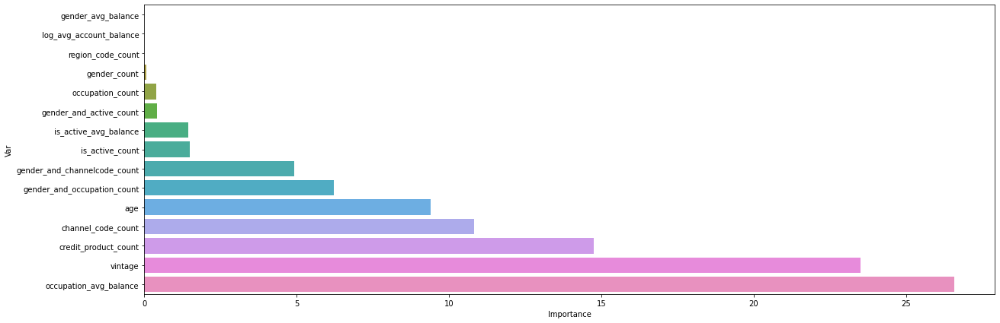

In [136]:
feature_importances(clf_cat,X_train,"Catoost_")

In [228]:
Log_model()

Model: CatBoostClassifier on noraml
Model parameters: n_estimators = 20,learning_rate = 0.02,rsm = 0.4 ,random_state=2054,verbose=False 
evaluation metrics: roc_auc_score
evaluation Score: 0.775494262612171
Additional comment: cross_val_score 0.7764449784069134 recall for 1 is 30%
Logged Successfully


* With Oversampling

In [142]:
clf_cat2 = CatBoostClassifier(n_estimators = 100,
                       learning_rate = 0.02,
                       rsm = 0.4, ## Analogous to colsample_bytree
                       random_state=2054,verbose=False
                       )

In [143]:
clf_cat2.fit(X_sm,y_sm)
clf_cat2_pred=clf_cat2.predict(X_val)

In [144]:
model_eval(clf_cat,X_sm,y_sm)

@@@@@@@@@@@@@@@cross_val_score@@@@@@@@@@@@@@@@@@@@@@
[0.77895892 0.78253765 0.78126291 0.78133527 0.78173575 0.77835541
 0.77696435 0.77754588 0.77897974 0.78530664] Avg Score:  0.7802982521349507
@@@@@@@@@@@@@@@@@@@@roc_auc_score@@@@@@@@@@@@@@@@@@
0.775494262612171
@@@@@@@@@@@@@@classification_report@@@@@@@@@@@@@@@@
              precision    recall  f1-score   support

           0       0.80      0.98      0.88     37487
           1       0.71      0.19      0.30     11658

    accuracy                           0.79     49145
   macro avg       0.75      0.58      0.59     49145
weighted avg       0.78      0.79      0.74     49145

@@@@@@@@@@@@@@@@@@@confusion_matrix@@@@@@@@@@@@@@@
[[36570   917]
 [ 9403  2255]]


@@@@@@@@@@@@@@Importance@@@@@@@@@
                             Var  Importance
0             gender_avg_balance    0.000000
1        log_avg_account_balance    0.000000
2              region_code_count    0.000000
3                   gender_count    0.066644
4               occupation_count    0.391346
5        gender_and_active_count    0.418001
6          is_active_avg_balance    1.428176
7                is_active_count    1.486429
8   gender_and_channelcode_count    4.921439
9    gender_and_occupation_count    6.223155
10                           age    9.403194
11            channel_code_count   10.814039
12          credit_product_count   14.754471
13                       vintage   23.499750
14        occupation_avg_balance   26.593355
@@@@@@@@@@@graph@@@@@@@@


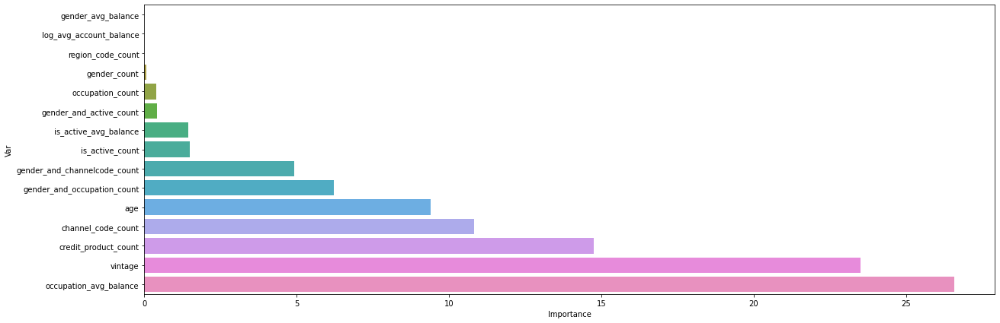

In [145]:
feature_importances(clf_cat,X_sm,"Catoost_with_over_sampling")

*  lgb
 * Without over sampling

In [146]:
lgb_clf =LGBMClassifier(
    boosting_type='gbdt',
    num_leaves=30,
    max_depth=7,
    learning_rate=0.1,
    n_estimators=150,
    categorical_feature=[6,7,8,9,10,11,12,13,14],
    subsample_for_bin=200000,
    objective=None,
    class_weight=None,
    min_split_gain=0.0,
    min_child_weight=0.001,
    min_child_samples=20,
    subsample=1.0,
    subsample_freq=0,
    colsample_bytree=1.0,
    reg_alpha=0.0,
    reg_lambda=0.0,
    random_state=42,
    n_jobs=-1,
    silent=True,
    importance_type='split'
)

In [147]:
lgb_clf.fit(X_train,y_train)

LGBMClassifier(categorical_feature=[6, 7, 8, 9, 10, 11, 12, 13, 14],
               max_depth=7, n_estimators=150, num_leaves=30, random_state=42)

In [148]:
model_eval(lgb_clf,X_train,y_train)

@@@@@@@@@@@@@@@cross_val_score@@@@@@@@@@@@@@@@@@@@@@
[0.791948   0.79698464 0.79519979 0.79656032 0.79788737 0.79148031
 0.79640689 0.78729456 0.79800849 0.80312041] Avg Score:  0.7954890782451824
@@@@@@@@@@@@@@@@@@@@roc_auc_score@@@@@@@@@@@@@@@@@@
0.7942886958975651
@@@@@@@@@@@@@@classification_report@@@@@@@@@@@@@@@@
              precision    recall  f1-score   support

           0       0.81      0.95      0.88     37487
           1       0.65      0.30      0.41     11658

    accuracy                           0.80     49145
   macro avg       0.73      0.63      0.65     49145
weighted avg       0.78      0.80      0.77     49145

@@@@@@@@@@@@@@@@@@@confusion_matrix@@@@@@@@@@@@@@@
[[35599  1888]
 [ 8125  3533]]


@@@@@@@@@@@@@@Importance@@@@@@@@@
                             Var  Importance
0                   gender_count           4
1                is_active_count           9
2             gender_avg_balance          29
3               occupation_count          45
4        gender_and_active_count         102
5             channel_code_count         114
6    gender_and_occupation_count         125
7   gender_and_channelcode_count         164
8          is_active_avg_balance         188
9         occupation_avg_balance         196
10          credit_product_count         200
11                       vintage         715
12                           age         755
13             region_code_count         824
14       log_avg_account_balance         880
@@@@@@@@@@@graph@@@@@@@@


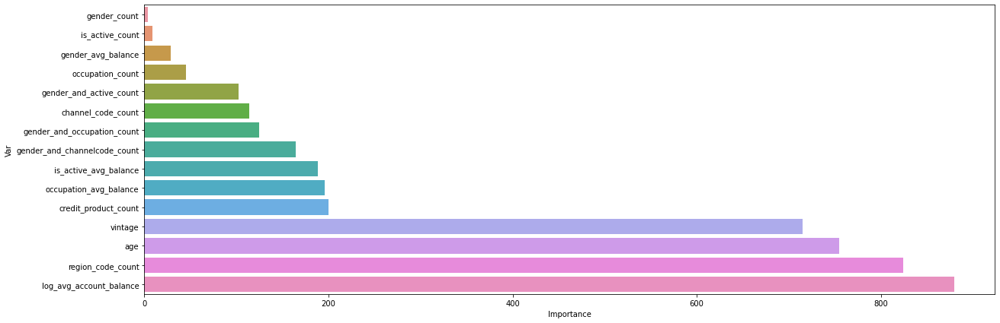

In [150]:
feature_importances(lgb_clf,X_train,'lgb_')

 * With Oversampling

In [152]:
lgb_clf2 =LGBMClassifier(
    boosting_type='gbdt',
    num_leaves=30,
    max_depth=7,
    learning_rate=0.1,
    n_estimators=150,
    categorical_feature=[6,7,8,9,10,11,12,13,14],
    subsample_for_bin=200000,
    objective=None,
    class_weight=None,
    min_split_gain=0.0,
    min_child_weight=0.001,
    min_child_samples=20,
    subsample=1.0,
    subsample_freq=0,
    colsample_bytree=1.0,
    reg_alpha=0.0,
    reg_lambda=0.0,
    random_state=42,
    n_jobs=-1,
    silent=True,
    importance_type='split'
)

In [153]:
lgb_clf2.fit(X_sm,y_sm)

LGBMClassifier(categorical_feature=[6, 7, 8, 9, 10, 11, 12, 13, 14],
               max_depth=7, n_estimators=150, num_leaves=30, random_state=42)

In [154]:
model_eval(lgb_clf,X_sm,y_sm)

@@@@@@@@@@@@@@@cross_val_score@@@@@@@@@@@@@@@@@@@@@@
[0.78649735 0.79220715 0.79297472 0.86158051 0.87400272 0.87083071
 0.87078787 0.86844259 0.8728143  0.8737125 ] Avg Score:  0.8463850413180964
@@@@@@@@@@@@@@@@@@@@roc_auc_score@@@@@@@@@@@@@@@@@@
0.7942886958975651
@@@@@@@@@@@@@@classification_report@@@@@@@@@@@@@@@@
              precision    recall  f1-score   support

           0       0.81      0.95      0.88     37487
           1       0.65      0.30      0.41     11658

    accuracy                           0.80     49145
   macro avg       0.73      0.63      0.65     49145
weighted avg       0.78      0.80      0.77     49145

@@@@@@@@@@@@@@@@@@@confusion_matrix@@@@@@@@@@@@@@@
[[35599  1888]
 [ 8125  3533]]


@@@@@@@@@@@@@@Importance@@@@@@@@@
                             Var  Importance
0                   gender_count           4
1                is_active_count           9
2             gender_avg_balance          29
3               occupation_count          45
4        gender_and_active_count         102
5             channel_code_count         114
6    gender_and_occupation_count         125
7   gender_and_channelcode_count         164
8          is_active_avg_balance         188
9         occupation_avg_balance         196
10          credit_product_count         200
11                       vintage         715
12                           age         755
13             region_code_count         824
14       log_avg_account_balance         880
@@@@@@@@@@@graph@@@@@@@@


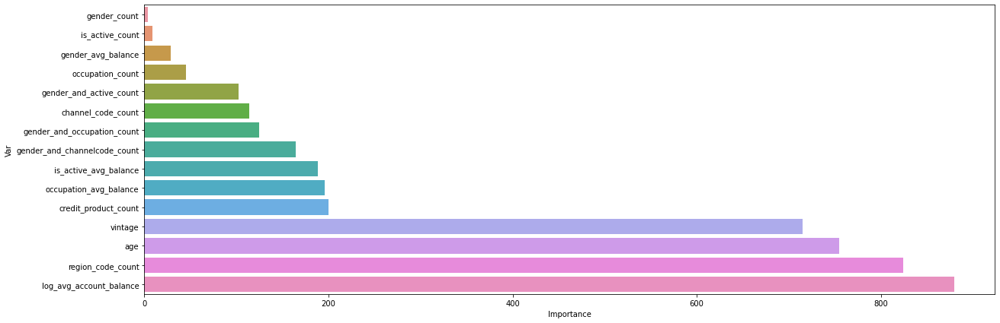

In [155]:
feature_importances(lgb_clf,X_sm,'lgb2_with_over_sampling')

In [229]:
Log_model()

Model: LGBMClassifier
Model parameters: (     boosting_type='gbdt',     num_leaves=30,     max_depth=7,     learning_rate=0.1,     n_estimators=150,     categorical_feature=[6,7,8,9,10,11,12,13,14],     subsample_for_bin=200000,     objective=None,     class_weight=None,     min_split_gain=0.0,     min_child_weight=0.001,     min_child_samples=20,     subsample=1.0,     subsample_freq=0,     colsample_bytree=1.0,     reg_alpha=0.0,     reg_lambda=0.0,     random_state=42,     n_jobs=-1,     silent=True,     importance_type='split' )
evaluation metrics: roc_auc_score
evaluation Score: 0.7942886958975651
Additional comment: cross_val_score 0.846385041318096
Logged Successfully


### Finalised Model 

Random Forest with oversample is finalized based on initial results

In [177]:
selected =[i for i in X_sm.columns.drop(['gender_count','gender_avg_balance','is_active_count','is_active_avg_balance'])]
X_sm_rf=X_sm[selected]
X_val_rf=X_val[selected]

In [178]:
RF_clf3=RandomForestClassifier(n_estimators=100)
RF_clf3.fit(X_sm_rf,y_sm)
RF_clf3_pred=RF_clf3.predict(X_val_rf)

In [179]:
model_eval2(RF_clf3,X_sm_rf,y_sm,X_val_rf)

@@@@@@@@@@@@@@@cross_val_score@@@@@@@@@@@@@@@@@@@@@@
[0.84609733 0.85068177 0.84579849 0.8979602  0.90810182 0.90615694
 0.90533042 0.90492957 0.90832085 0.90829695] Avg Score:  0.8881674349380215
@@@@@@@@@@@@@@@@@@@@roc_auc_score@@@@@@@@@@@@@@@@@@
0.7550660325441668
@@@@@@@@@@@@@@classification_report@@@@@@@@@@@@@@@@
              precision    recall  f1-score   support

           0       0.85      0.79      0.82     37487
           1       0.45      0.57      0.51     11658

    accuracy                           0.74     49145
   macro avg       0.65      0.68      0.66     49145
weighted avg       0.76      0.74      0.75     49145

@@@@@@@@@@@@@@@@@@@confusion_matrix@@@@@@@@@@@@@@@
[[29515  7972]
 [ 5021  6637]]


@@@@@@@@@@@@@@Importance@@@@@@@@@
                             Var  Importance
0               occupation_count    0.007536
1    gender_and_occupation_count    0.011135
2         occupation_avg_balance    0.016899
3        gender_and_active_count    0.020879
4           credit_product_count    0.026701
5   gender_and_channelcode_count    0.038329
6             channel_code_count    0.057972
7              region_code_count    0.140035
8                            age    0.196603
9                        vintage    0.207975
10       log_avg_account_balance    0.275936
@@@@@@@@@@@graph@@@@@@@@


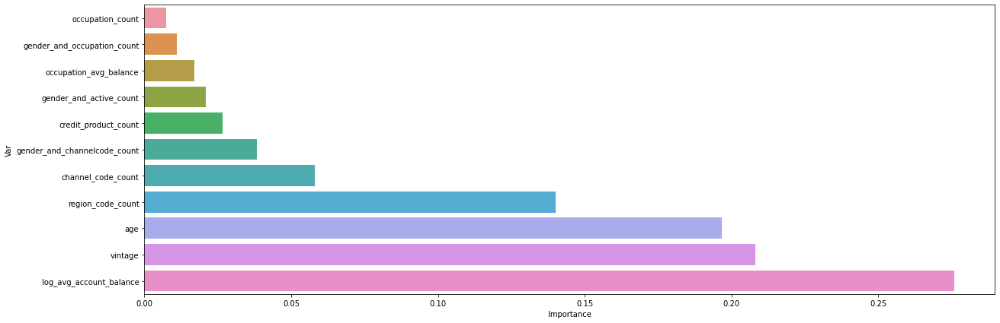

In [180]:
feature_importances(RF_clf3,X_sm_rf,'RF_with_over_sampling_f')

In [181]:
Log_Message()

Enter Message: After removing avg cross_val_score 0.8881674349380215, roc_auc_score 0.7550660325441668
Logged Successfully


In [173]:
Log_model()

Model: RF
Model parameters: n_estimators=100
evaluation metrics: roc_auc_score
evaluation Score: 0.7537181288895882
Additional comment: cross val score 0.887116293404904
Logged Successfully


To get max out of model lets fine tune it

In [188]:
param={'bootstrap': [True, False],
 'max_depth': [10, 20, 30, 40,50, None],
 'max_features': ['auto', 'sqrt'],
 'min_samples_leaf': [1, 2,3,4],
 'min_samples_split': [2, 5,8],
 'n_estimators': [20,50,100,150]}

In [189]:
%%time
forest = RandomizedSearchCV(RandomForestClassifier(), param, cv = 5,n_jobs=-1,return_train_score=True)
forest.fit(X_sm_rf,y_sm)

Wall time: 7min 10s


RandomizedSearchCV(cv=5, estimator=RandomForestClassifier(), n_jobs=-1,
                   param_distributions={'bootstrap': [True, False],
                                        'max_depth': [10, 20, 30, 40, 50, None],
                                        'max_features': ['auto', 'sqrt'],
                                        'min_samples_leaf': [1, 2, 3, 4],
                                        'min_samples_split': [2, 5, 8],
                                        'n_estimators': [20, 50, 100, 150]},
                   return_train_score=True)

In [194]:
print(forest.best_params_)
print(forest.best_score_)
print(forest.best_estimator_)

{'n_estimators': 20, 'min_samples_split': 5, 'min_samples_leaf': 1, 'max_features': 'sqrt', 'max_depth': 40, 'bootstrap': False}
0.7990496832277426
RandomForestClassifier(bootstrap=False, max_depth=40, max_features='sqrt',
                       min_samples_split=5, n_estimators=20)


In [197]:
RF_clf_final=RandomForestClassifier(bootstrap=False, max_depth=40, max_features='sqrt',
                       min_samples_split=5, n_estimators=20)
RF_clf_final.fit(X_sm_rf,y_sm)
RF_clf_final_pred=RF_clf_final.predict(X_val_rf)

In [198]:
model_eval2(RF_clf_final,X_sm_rf,y_sm,X_val_rf)

@@@@@@@@@@@@@@@cross_val_score@@@@@@@@@@@@@@@@@@@@@@
[0.83636282 0.84042056 0.83745565 0.8946123  0.90287865 0.90301405
 0.90253785 0.9021972  0.90521604 0.90398121] Avg Score:  0.8828676334369987
@@@@@@@@@@@@@@@@@@@@roc_auc_score@@@@@@@@@@@@@@@@@@
0.7404579032585816
@@@@@@@@@@@@@@classification_report@@@@@@@@@@@@@@@@
              precision    recall  f1-score   support

           0       0.85      0.79      0.82     37487
           1       0.45      0.54      0.49     11658

    accuracy                           0.73     49145
   macro avg       0.65      0.67      0.65     49145
weighted avg       0.75      0.73      0.74     49145

@@@@@@@@@@@@@@@@@@@confusion_matrix@@@@@@@@@@@@@@@
[[29701  7786]
 [ 5381  6277]]


Well our model has cross_val_score 88% and roc_auc_score 74% on unseen data

### Test data predictions

In [216]:
test_pred=RF_clf_final.predict(test_final[selected])

In [217]:
test_pred

array([0, 0, 0, ..., 0, 1, 0])

In [220]:
test['is_lead']=test_pred

In [223]:
test[['ID','is_lead']].to_csv("test_data_predictions.csv",index=False)

In [232]:
Log_Message()

Enter Message: ########@@@@@ END @@@@@@#### Thank you #######@@@@@@@@
Logged Successfully
